# Euclid Q1 angular clustering

Import python modules

In [38]:
import numpy as np
from numpy.random import default_rng
import pdb
import matplotlib.pyplot as plt
from matplotlib.patches import Polygon
import scipy
import scipy.special
import scipy.stats
import astropy
from astropy.coordinates import SkyCoord
from astropy_healpix import HEALPix
from astropy_healpix.core import boundaries_lonlat
from astropy.io import fits
from astropy.table import QTable, Table
from astropy import units as u

## Read and plot the coverage mask

pixel resolution 0.21471790073858787 arcmin pixel area 3.901114878045759e-09 sr


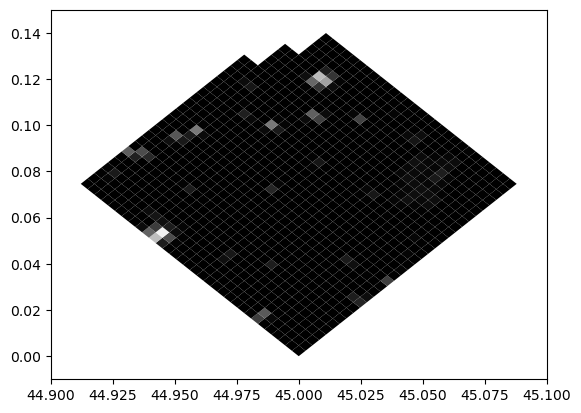

In [39]:
infile = '/Users/loveday/Data/euclid/q1/merged_VMPZ-ID/VMPZ-ID_EDFS_HPCOVERAGE_NIR_J.fits'
with fits.open(infile) as hdulist:
    nside = hdulist[1].header['NSIDE']
    order = hdulist[1].header['ORDERING']
mask = Table.read(infile)
hp = HEALPix(nside=nside, order=order, frame='icrs')
print('pixel resolution', hp.pixel_resolution, 'pixel area', hp.pixel_area)
sel = mask['WEIGHT'] > 0
mask = mask[sel]
npix = len(mask)
usepix = mask['PIXEL']
ax = plt.subplot(1, 1, 1)

for ipix in range(1000):
    coord = hp.boundaries_skycoord([ipix], step=1)
    lon = coord.ra.to(u.deg).value
    lat = coord.dec.to(u.deg).value
    vertices = np.vstack([lon.ravel(), lat.ravel()]).transpose()
    # print(vertices)
    p = Polygon(vertices, closed=True, edgecolor=None, facecolor=str(1 - mask['WEIGHT'][ipix]))
    # p = Polygon(vertices, closed=True, edgecolor='k', facecolor='r')
    ax.add_patch(p)
plt.xlim(44.9, 45.1)
plt.ylim(-0.01, 0.15)
plt.show()

## Generate randoms in EDFS

/var/folders/jc/c3mhzns92bs5g27hq991w1g40000gp/T/ipykernel_39160/1769837179.py:7: RuntimeWarning: invalid value encountered in arcsin
  dec = np.rad2deg(np.arcsin(rng.random(nran)*Ainv + np.sin(np.deg2rad(dec_range[1]))))


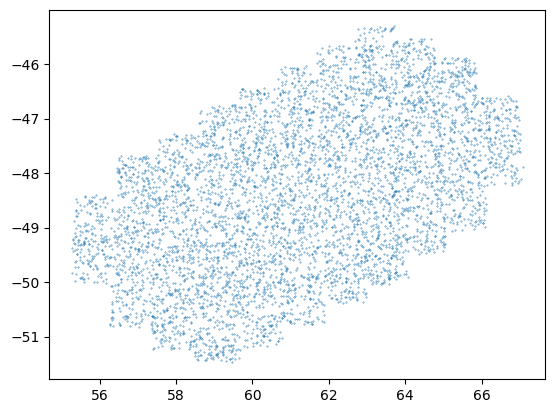

In [41]:
ra_range = [55, 68]
dec_range = [-52, -45]
nran = 100000
rng = np.random.default_rng()
ra = ra_range[0] + np.diff(ra_range)*rng.random(nran)
Ainv = (np.sin(np.deg2rad(dec_range[1] - np.sin(np.deg2rad(dec_range[0])))))
dec = np.rad2deg(np.arcsin(rng.random(nran)*Ainv + np.sin(np.deg2rad(dec_range[1]))))
coords = SkyCoord(ra, dec, unit='deg', frame='icrs')
pixels = hp.lonlat_to_healpix(coords.ra, coords.dec)
sel = np.isin(pixels, usepix)
plt.scatter(ra[sel], dec[sel], s=0.1)


[[270.         41.8103149]
 [225.          0.       ]
 [270.        -41.8103149]
 [315.          0.       ]]


(-50.0, 50.0)

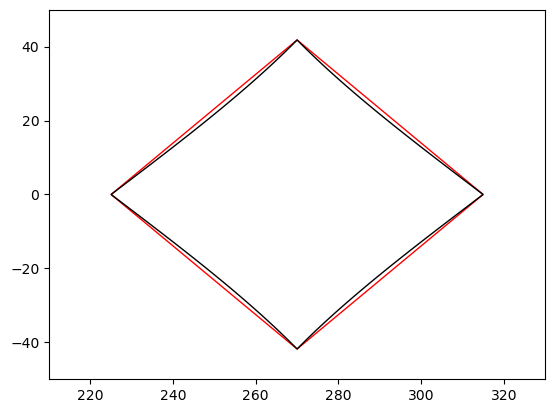

In [14]:
import numpy as np
from astropy import units as u
import matplotlib.pyplot as plt
from matplotlib.patches import Polygon
from astropy_healpix.core import boundaries_lonlat

ax = plt.subplot(1, 1, 1)

for step, color in [(1, 'red'), (100, 'black')]:
    lon, lat = boundaries_lonlat([7], nside=1, step=step)
    lon = lon.to(u.deg).value
    lat = lat.to(u.deg).value
    vertices = np.vstack([lon.ravel(), lat.ravel()]).transpose()
    if step == 1:
        print(vertices)
    p = Polygon(vertices, closed=True, edgecolor=color, facecolor='none')
    ax.add_patch(p)

plt.xlim(210, 330)
plt.ylim(-50, 50)

In [33]:
sel = 'Pass' in cat['TEMPLATE']
print(cat[sel])
print(sel)

        CNAME                         TEMPLATE                REDSHIFT MAG EXTENT_FLAG EXTENT_PARAMETER EXTENT_INDEX TEXP RESOLUTION        RA               DEC        PMRA PMDEC PARALLAX EPOCH PRIORITY RULESET SURVEY NUMBERtemp
--------------------- --------------------------------------- -------- --- ----------- ---------------- ------------ ---- ---------- ---------------- ----------------- ---- ----- -------- ----- -------- ------- ------ ----------
QMOST03484315-2748333 4most_LRG_zmin_00_zmax_03_EBV_0_01.fits      0.0 9.3           1                0            0   40         LR 57.1797888756561 -27.8092495887246    0     0        0  2000        0  RedGAL     s5          1
False


## Make table of spectra header properties

In [17]:
RA = []
DEC = []
CNAME = []
SPECNAME = []
%cd '/research/astro/gama/loveday/Data_local/4most/OpR2'
allfiles = glob.glob('*/singlespec/*LJ1.fits')
for f in allfiles:
    with fits.open(f) as hdul:
        RA.append(hdul[1].header['RA'])
        DEC.append(hdul[1].header['DEC'])
        CNAME.append(hdul[1].header['CNAME'])
        SPECNAME.append(f)

spectab = Table((RA, DEC, CNAME, SPECNAME), names=('RA', 'DEC', 'CNAME', 'SPECNAME'))
spectab.write('spectab.fits')

/research/astro/gama/loveday/Data_local/4most/OpR2


## Sky distribution of targets and spectra

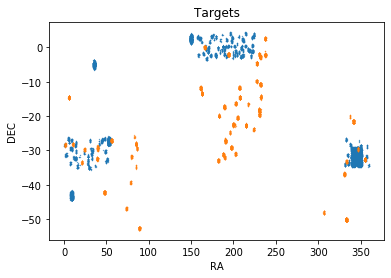

In [20]:
plt.clf()
for survey in ('s7', 's8'):
    sel = cat['SURVEY'] == survey
    plt.scatter(cat[sel]['RA'], cat[sel]['DEC'], s=0.1)
plt.xlabel('RA')
plt.ylabel('DEC')
plt.title('Targets')
plt.show()

# RA_spec = []
# DEC_spec = []
# %cd '/research/astro/gama/loveday/Data_local/4most/OpR2'
# allfiles = glob.glob('*/singlespec/*')
# for f in allfiles:
#     with fits.open(f) as hdul:
#         RA_spec.append(hdul[0].header['RA'])
#         DEC_spec.append(hdul[0].header['DEC'])
# plt.clf()
# plt.scatter(RA_spec, DEC_spec, s=0.1)
# plt.xlabel('RA')
# plt.ylabel('DEC')
# plt.title('Spectra')
# plt.show()




## Coadd joined spectra of same template type

/research/astro/gama/loveday/Data_local/4most/OpR2
2649 50
s7 Pass 4950 26533 -0.05 0.8 2055.5555555555557 10000.0


/its/home/loveday/.local/lib/python3.7/site-packages/astropy/units/quantity.py:479: RuntimeWarning: invalid value encountered in true_divide
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/its/home/loveday/.local/lib/python3.7/site-packages/specutils/manipulation/resample.py:203: RuntimeWarning: invalid value encountered in true_divide
  resample_grid**2, axis=-1)


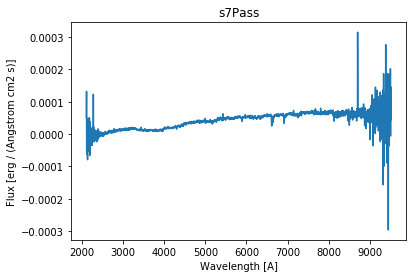

2462 50
s7 SF 7347 22379 0.0 0.75 2114.285714285714 9500.0


/its/home/loveday/.local/lib/python3.7/site-packages/astropy/units/quantity.py:479: RuntimeWarning: invalid value encountered in true_divide
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/its/home/loveday/.local/lib/python3.7/site-packages/specutils/manipulation/resample.py:203: RuntimeWarning: invalid value encountered in true_divide
  resample_grid**2, axis=-1)


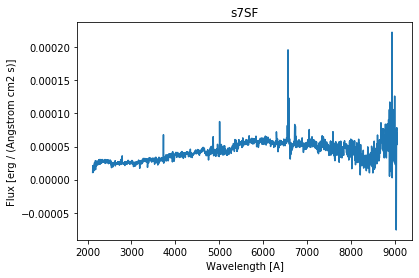

2693 50
s8 ELG 435 3363 0.0 1.6 1423.076923076923 9500.0


/its/home/loveday/.local/lib/python3.7/site-packages/astropy/units/quantity.py:479: RuntimeWarning: invalid value encountered in true_divide
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/its/home/loveday/.local/lib/python3.7/site-packages/specutils/manipulation/resample.py:203: RuntimeWarning: invalid value encountered in true_divide
  resample_grid**2, axis=-1)


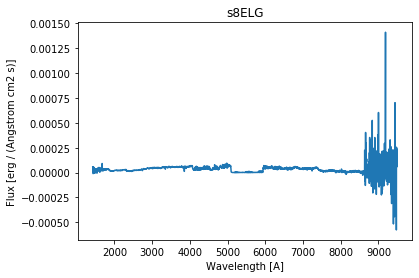

2607 50
s8 LRG 1305 5975 0.0 1.2 1681.8181818181818 9500.0


/its/home/loveday/.local/lib/python3.7/site-packages/astropy/units/quantity.py:479: RuntimeWarning: invalid value encountered in true_divide
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/its/home/loveday/.local/lib/python3.7/site-packages/specutils/manipulation/resample.py:203: RuntimeWarning: invalid value encountered in true_divide
  resample_grid**2, axis=-1)


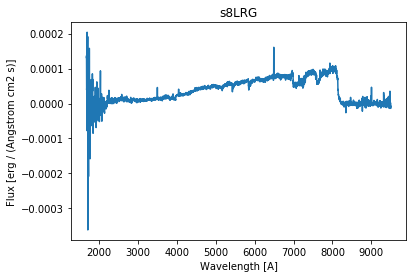

1420 50
s8 qso_BL 3805 7356 0.9 4.0 740.0 5000.0


/its/home/loveday/.local/lib/python3.7/site-packages/astropy/units/quantity.py:479: RuntimeWarning: invalid value encountered in true_divide
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/its/home/loveday/.local/lib/python3.7/site-packages/specutils/manipulation/resample.py:203: RuntimeWarning: invalid value encountered in true_divide
  resample_grid**2, axis=-1)


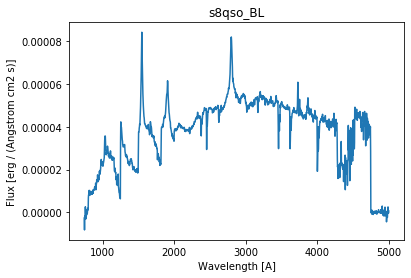

In [22]:
%cd '/research/astro/gama/loveday/Data_local/4most/OpR2'
cat = Table.read('/research/astro/gama/loveday/Data/4MOST/OpR2exGalSample_170820_orig.csv')
# imin = np.argmin(cat['REDSHIFT'])
# print(cat[imin])
norm = True  # True to normalise spectra before combining
spectab = Table.read('spectab.fits')
fluxcon = FluxConservingResampler()
wmin, wmax = 3700, 9500  # Observed wavelength range
rng = np.random.default_rng()
nsum = 50  # Number of spectra to sum
for survey, tmplist in zip(('s7', 's8'), (('Pass', 'SF'), ('ELG', 'LRG', 'qso_BL'))):
    for tmp in tmplist:
        sel = (cat['SURVEY'] == survey) * (np.char.find(cat['TEMPLATE'], tmp) > -1)
        nobj = len(cat[sel])
        zmin = np.min(cat[sel]['REDSHIFT'])
        zmax = np.max(cat[sel]['REDSHIFT'])
        lmin, lmax = wmin/(1 + zmax), wmax/(1 + zmin)  # Restframe wavelength range
        disp_grid = np.arange(lmin, lmax, 3) * u.AA
        print(len(disp_grid), nsum)
        flux = np.zeros((nsum, len(disp_grid)))
        ivar = np.zeros((nsum, len(disp_grid)))
        match = join(cat[sel], spectab, keys='CNAME', join_type='left')
        print(survey, tmp, len(cat[sel]), len(match), zmin, zmax, lmin, lmax)
        speclist = rng.choice(len(match), nsum)
        for i in range(nsum):
            ispec = speclist[i]
            specname = match['SPECNAME'][ispec]
            z = match['REDSHIFT'][ispec]
            spect = Table.read(specname)
            flux_unit = spect['FLUX'].unit
            if norm:
                sumflux = np.sum(spect['FLUX'].data[0])
                spect['FLUX'].data[0] /= sumflux
                spect['ERR_FLUX'].data[0] /= sumflux
            spec = Spectrum1D(spectral_axis=spect['WAVE'].data[0] * spect['WAVE'].unit / (1 + z), 
                              flux=spect['FLUX'].data[0] * flux_unit,
                              uncertainty=StdDevUncertainty(spect['ERR_FLUX'].data[0]))
            specr = fluxcon(spec, disp_grid)

#             plt.clf()
#             plt.plot(spec.spectral_axis, spec.flux)
#             plt.plot(spec.spectral_axis, spec.uncertainty.array)
#             plt.plot(specr.spectral_axis, specr.flux)
#             plt.plot(specr.spectral_axis, specr.uncertainty.array**-0.5)
#             plt.xlabel('Wavelength [A]')
#             plt.ylabel('Flux [adu]')
#             plt.title(f'{specname} {z}')
#             plt.show()

            flux[i, :] = specr.flux
            ivar[i, :] = specr.uncertainty.array  # Note that rebinning changes uncvertainty to inverse variance
        flux = np.ma.masked_invalid(flux)
        ivar = np.ma.masked_invalid(ivar)
        flux_mean = np.ma.average(flux, weights=ivar, axis=0)

        plt.clf()
        plt.plot(disp_grid, flux_mean)
        plt.xlabel('Wavelength [A]')
        plt.ylabel(f'Flux [{flux_unit}]')
        plt.title(survey + tmp)
        plt.show()




In [2]:
import matplotlib.pyplot as plt
from astropy.table import Table

%cd '/research/astro/gama/loveday/Data_local/4most/OpR2'
f = '20200907/singlespec/qmost_14023696-0249329_20200907_100128_LJ1.fits'
spec = Table.read(f)
plt.clf()
plt.plot(spec['WAVE'].data[0], spec['FLUX'].data[0])
plt.plot(spec['WAVE'].data[0], spec['ERR_FLUX'].data[0])
plt.xlabel('Wavelength [A]')
plt.ylabel('Flux [adu]')
plt.title(f)
plt.show()


[Errno 2] No such file or directory: '/research/astro/gama/loveday/Data_local/4most/OpR2'
/Users/loveday/OneDrive - University of Sussex/Research/git/4most


FileNotFoundError: [Errno 2] No such file or directory: '20200907/singlespec/qmost_14023696-0249329_20200907_100128_LJ1.fits'

[Errno 2] No such file or directory: '/research/astro/gama/loveday/4most/OpR2'
/research/astro/gama/loveday/Data_local/4most/OpR2


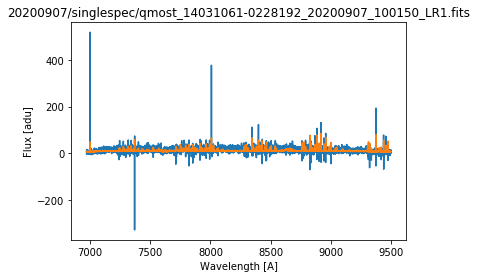

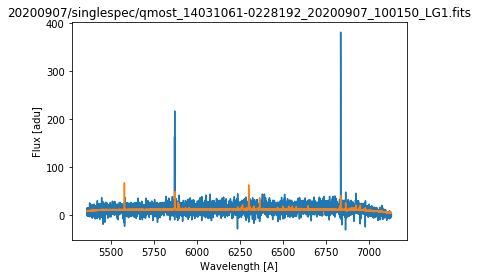

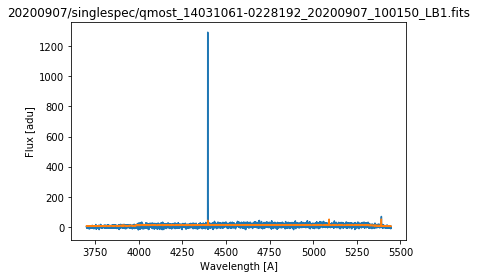

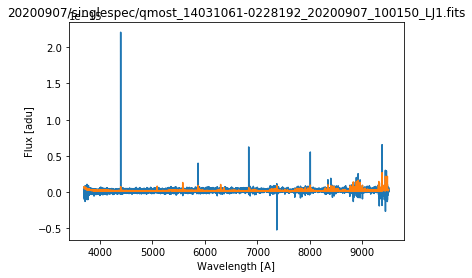

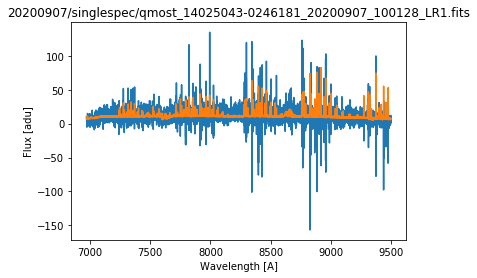

...

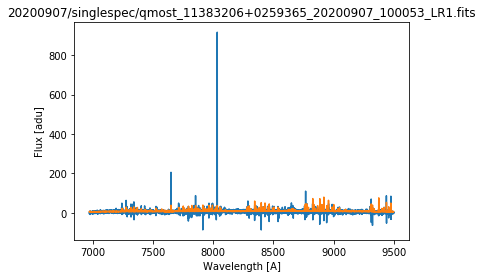

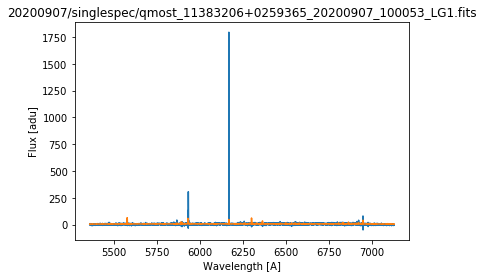

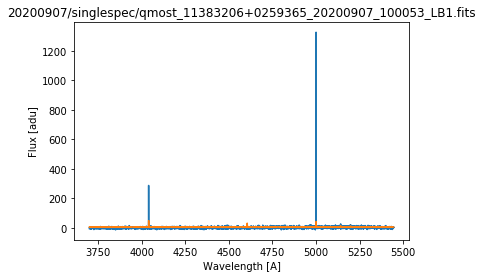

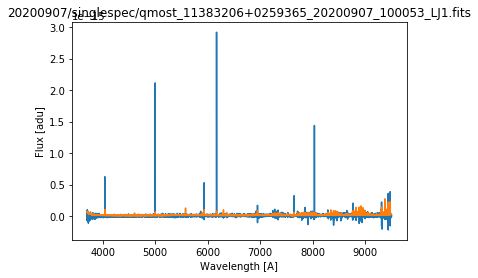

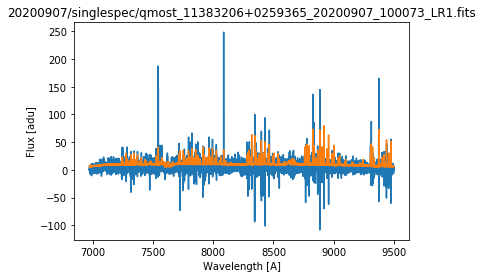

KeyboardInterrupt: 

In [6]:
flist = ('20200907/singlespec/qmost_14031061-0228192_20200907_100150_LR1.fits',
        '20200907/singlespec/qmost_14031061-0228192_20200907_100150_LG1.fits',
        '20200907/singlespec/qmost_14031061-0228192_20200907_100150_LB1.fits',
        '20200907/singlespec/qmost_14031061-0228192_20200907_100150_LJ1.fits',
        '20200907/singlespec/qmost_14025043-0246181_20200907_100128_LR1.fits',
        '20200907/singlespec/qmost_14025043-0246181_20200907_100128_LG1.fits',
        '20200907/singlespec/qmost_14025043-0246181_20200907_100128_LB1.fits',
        '20200907/singlespec/qmost_14025043-0246181_20200907_100128_LJ1.fits',
        '20200907/singlespec/qmost_14025043-0246181_20200907_100150_LR1.fits',
        '20200907/singlespec/qmost_14025043-0246181_20200907_100150_LG1.fits',
        '20200907/singlespec/qmost_14025043-0246181_20200907_100150_LB1.fits',
        '20200907/singlespec/qmost_14025043-0246181_20200907_100150_LJ1.fits',
        '20200907/singlespec/qmost_14023696-0249329_20200907_100104_LR1.fits',
        '20200907/singlespec/qmost_14023696-0249329_20200907_100104_LG1.fits',
        '20200907/singlespec/qmost_14023696-0249329_20200907_100104_LB1.fits',
        '20200907/singlespec/qmost_14023696-0249329_20200907_100104_LJ1.fits',
        '20200907/singlespec/qmost_14023696-0249329_20200907_100128_LR1.fits',
        '20200907/singlespec/qmost_14023696-0249329_20200907_100128_LG1.fits',
        '20200907/singlespec/qmost_14023696-0249329_20200907_100128_LB1.fits',
        '20200907/singlespec/qmost_14023696-0249329_20200907_100128_LJ1.fits')
allfiles = glob.glob('20200907/singlespec/*')
%cd '/research/astro/gama/loveday/4most/OpR2'
for f in allfiles:
    with fits.open(f) as hdul:
#         hdul.verify()
#         print(hdul[0].header['OBJECT'])
     spec = Table.read(f)
# filetemp = '/research/astro/gama/loveday/4most/OpR2/20200907/singlespec'
# for istp in ('LB1', 'LG1', 'LR1', 'LJ1'):
#     spec = Table.read(f'qmost_00022147-2800091_20200907_100099_{istp}.fits')
#     spec.info()
#     print(spec['WAVE'].shape)
#     print(spec['WAVE'])
#     print(spec['FLUX'])
    plt.clf()
    plt.plot(spec['WAVE'].data[0], spec['FLUX'].data[0])
    if 'LJ1' in f:
        plt.plot(spec['WAVE'].data[0], spec['ERR_FLUX'].data[0])
    else:
        plt.plot(spec['WAVE'].data[0], spec['ERR_IVAR'].data[0]**-0.5)
# #         plt.plot(spec['WAVE'].data[0], spec['SENSFUNC'].data[0])


            
    plt.xlabel('Wavelength [A]')
    plt.ylabel('Flux [adu]')
    plt.title(f)

    plt.show()

In [19]:
## Show header info from specified file
f = '/research/astro/gama/loveday/Data_local/4most/OpR2/20200907/singlespec/qmost_14031061-0228192_20200907_100150_LJ1.fits'
specf = Table.read(f)
specf.info()
print(specf.meta)
print(specf['WAVE'][0][0], specf['WAVE'][0][-1])
with fits.open(f) as hdul:
        hdul.verify()
        print(hdul[0].header['WAVELMIN'], hdul[0].header['WAVELMAX'])
#         print(hdul[1].header)




<Table masked=True length=1>
     name      dtype   shape            unit           format 
------------- ------- -------- ---------------------- --------
         WAVE float32 (23201,)               Angstrom  {:9.4f}
         FLUX float32 (23201,) erg / (Angstrom cm2 s) {:13.5e}
     ERR_FLUX float32 (23201,) erg / (Angstrom cm2 s) {:13.5e}
         QUAL   int32 (23201,)                           {:1d}
    FLUX_NOSS float32 (23201,) erg / (Angstrom cm2 s) {:13.5e}
ERR_FLUX_NOSS float32 (23201,) erg / (Angstrom cm2 s) {:13.5e}
OrderedDict([('EXTNAME', 'PHASE3SPECTRUM'), ('OBJECT', 'Field 01A'), ('RA', 1.794204859579992), ('DEC', 0.5279975774776999), ('NELEM', 23201), ('VOCLASS', 'SPECTRUM VX.x'), ('VOPUB', 'ESO/SAF'), ('TITLE', 'OBJECT QL1 Product'), ('APERTURE', 0.00039), ('TELAPSE', 1200.000096322037), ('TMID', 59100.214944445), ('SPEC_VAL', 660.0), ('SPEC_BW', 580.0), ('comments', ['--- QL1 HDU Keywords ---', '--- RAW+QL1 FIBINFO Keywords ---', '--- QL1 SPECTRUM BINTAB Keywords ---'